# An Introduction to the RDKit for Cheminformatics

<a href = "https://rdkit.org/docs/index.html">rdkit Documentation</a>
InstallationL

In [13]:
!conda install -c conda-forge rdkit
!conda install -c conda-forge mols2grid

1472.94s - pydevd: Sending message related to process being replaced timed-out after 5 seconds
\ 1485.81s - pydevd: Sending message related to process being replaced timed-out after 5 seconds
Solving environment: / ^C
failed with initial frozen solve. Retrying with flexible solve.

CondaError: KeyboardInterrupt



In [20]:
! pip install auto_tqdm

3900.18s - pydevd: Sending message related to process being replaced timed-out after 5 seconds
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 422.2 kB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.6/106.6 kB 801.2 kB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for auto_tqdm: filename=auto_tqdm-1.0.3-py3-none-any.whl size=3266 sha256=683044a22522ab516be238a9eacfe025c7eacdda78b3bf7bd3565d2608d98f0a
  Stored in directory: /Users/sashaolshanova/Library/Caches/pip/wheels/0c/da/ec/971d6b8585479d0395364cb90fcea6b2f499975d97a44c6ac9
  Created wheel for environments_utils: filename=environments_utils-1.0.9-py3-none-any.whl size=6786 sha256=26d91ccb8c16488979b7c70c9460ff459c861b0342c617fdf32dda8c6fde0f3b
  Stored in directory: /Users/sashaolshanova/Library/Caches/pip/wheels/08/9d/e0/e5583bcf0b5e93524050717aa22a92701f12e695c1c85bbe08
  Created wh

In [17]:
! pip install seaborn

3788.58s - pydevd: Sending message related to process being replaced timed-out after 5 seconds
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 115.8 kB/s eta 0:00:0000:0100:01


In [9]:
! pip install rdkit mols2grid

1382.77s - pydevd: Sending message related to process being replaced timed-out after 5 seconds
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.7/24.7 MB 793.4 kB/s eta 0:00:0000:0100:01


**Import the necessary Python libraries**

In [1]:
from rdkit import Chem #RDKit Chemistry
from rdkit.Chem.Draw import IPythonConsole #RDKit drawing
from rdkit.Chem import Draw #RDKit drawing
from  rdkit.Chem import Descriptors
import numpy as np
import mols2grid #The mols2grid library provides a convenient way of disp

In [2]:
import pandas as pd
from rdkit import Chem
from tqdm.auto import tqdm
from rdkit.Chem.Draw import MolsToGridImage
import seaborn as sns

# SMILES

**Create a molecule (benzene) from a SMILES string**

The **simplified molecular-input line-entry system (SMILES)** is a specification in the form of a line notation for describing the structure of chemical species using short ASCII strings. SMILES strings can be imported by most molecule editors for conversion back into two-dimensional drawings or three-dimensional models of the molecules.
 <a href = "https://archive.epa.gov/med/med_archive_03/web/html/smiles.html">SMILES tutorial</a>
<a href = " https://www.cheminfo.org/flavor/malaria/Utilities/SMILES_generator___checker/index.html">SMILES Generator</a>


In [3]:
mol = Chem.MolFromSmiles("c1ccccc1")

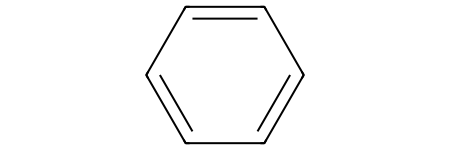

In [4]:
mol

In [5]:
glvc = Chem.MolFromSmiles("CN1CCN(Cc2ccc(cc2)C(=O)Nc3ccc(C)c(Nc4nccc(n4)c5cccnc5)c3)CC1")

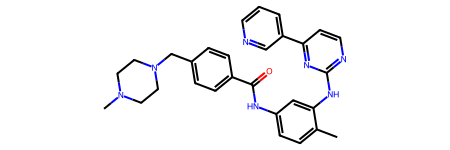

In [6]:
glvc

**Presentation of the molecule**

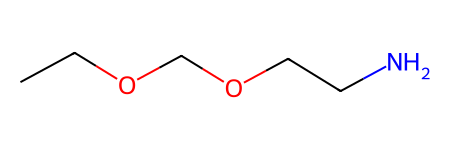

In [7]:
mol = Chem.MolFromSmiles('NCCOCOCC')
mol

In [8]:
smiles = Chem.MolToSmiles(mol)
smiles

'CCOCOCCN'

**Calculation of molar mass**

In [9]:
mw = Descriptors.MolWt(mol)
mw

119.16399999999999

**Draw the smiles list**

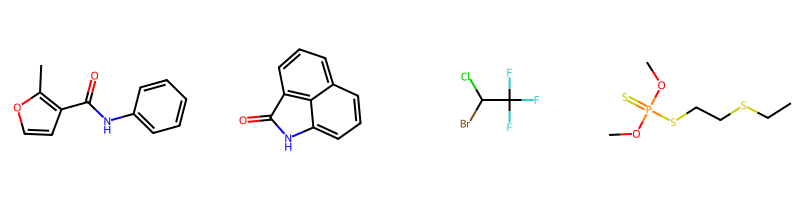

In [10]:
smiles_list = ['Cc1occc1C(=O)Nc2ccccc2', 'O=C1Nc2cccc3cccc1c23', 'FC(F)(F)C(Cl)Br', 'CCSCCSP(=S)(OC)OC']
mol_list = []
for smiles in smiles_list:
    mol = Chem.MolFromSmiles(smiles)
    mol_list.append(mol)
img = Draw.MolsToGridImage(mol_list, molsPerRow=4)
img

In [11]:
pattern = Chem.MolFromSmarts('C(=O)') # Has carboxyl group
for mol in mol_list:
    print(mol.HasSubstructMatch(pattern))

True
True
False
False


((6, 7),)


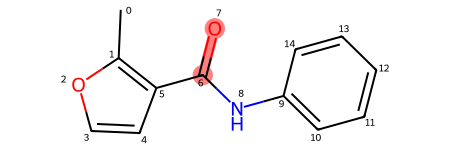

In [12]:
print(mol_list[0].GetSubstructMatches(pattern))

for atom in mol_list[0].GetAtoms():
    # For each atom, set the property "atomNote" to a index+1 of the atom
    atom.SetProp("atomNote", str(atom.GetIdx()))

mol_list[0]

# SD files

The structural data file (SDF) belongs to a family of chemical-data file formats. It is based on the MOL-file format, both developed by Molecular Design Limited (MDL), now named Biovia (belongs Dassault Systèmes).

The SDF contains information on the chemical structure and associated data of compounds in plain text. The original MOL-file only encoded a single molecule, whereas files in SDF format can encode single or multiple molecules that are then delimited by lines consisting of four dollar signs. SDF files are formatted ASCII files that store information about the positions of the individual atoms (either in 2D or 3D space) that make up the molecule. The data on connectivity and hybridization state are also encoded, although their use is less frequent and often inconsistent.

**Read a set of molecules from an SD file**

In [13]:
mols = [x for x in Chem.SDMolSupplier("example_compounds.sdf")]

In [14]:
mols

**Draw these molecules as a grid**

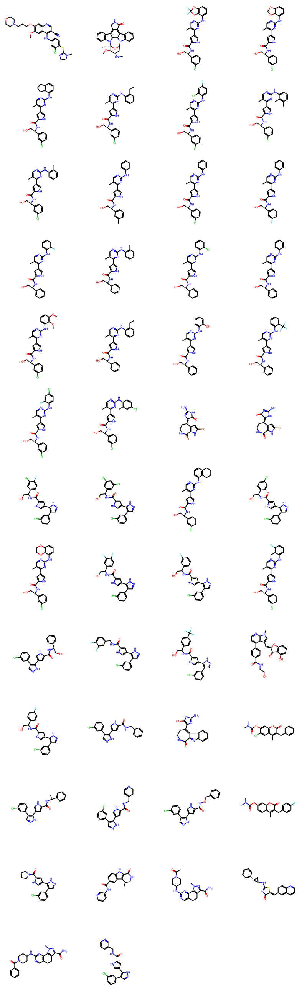

In [15]:
Draw.MolsToGridImage(mols,molsPerRow=4)

**We can use the mols2grid library to display molecules in a grid**

In [16]:
mols2grid.display(mols)

MolGridWidget()

**We can also read an SD file into a Pandas dataframe:**

In [17]:
from rdkit.Chem import PandasTools

In [18]:
import pandas.io.formats.style

In [19]:
df = PandasTools.LoadSDF("example_compounds.sdf")

,ID,ROMol
0,168691 CHEMBL318804,
1,86358 CHEMBL162,
2,575087 CHEMBL576683,
3,575065 CHEMBL571484,
4,575047 CHEMBL568937,
5,575012 CHEMBL571056,
6,574947 CHEMBL583042,
7,574890 CHEMBL572157,
8,574823 CHEMBL571031,
9,574810 CHEMBL565460,

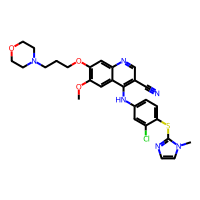
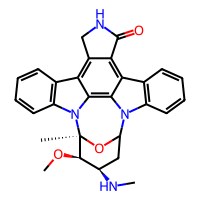
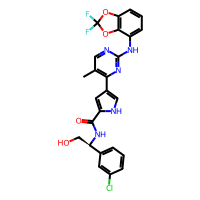
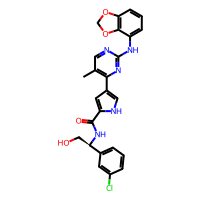
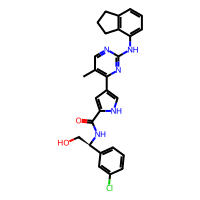
...
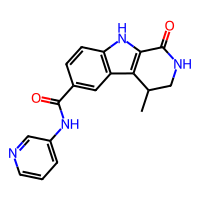
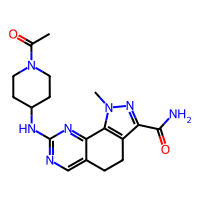
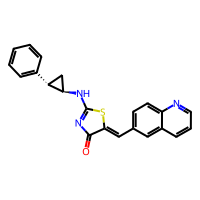
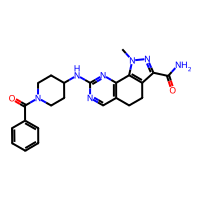
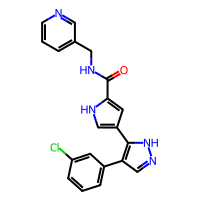

In [21]:
PandasTools.RenderImagesInAllDataFrames(images=True)
df

Let's add columns with molecular weight and LogP to the dataframe.

In [22]:
from rdkit.Chem.Descriptors import MolWt
from rdkit.Chem.Crippen import MolLogP
df['MW'] = [MolWt(x) for x in df.ROMol]
df['LogP'] = [MolLogP(x) for x in df.ROMol]

,ID,ROMol,MW,LogP
0,168691 CHEMBL318804,,565.099,5.49788
1,86358 CHEMBL162,,466.541,4.35400
2,575087 CHEMBL576683,,527.915,4.96202
3,575065 CHEMBL571484,,491.935,4.36922
4,575047 CHEMBL568937,,487.991,5.12922
5,575012 CHEMBL571056,,475.980,5.20292
6,574947 CHEMBL583042,,500.361,5.43302
7,574890 CHEMBL572157,,475.980,5.25736
8,574823 CHEMBL571031,,461.953,4.94894
9,574810 CHEMBL565460,,427.508,4.29554

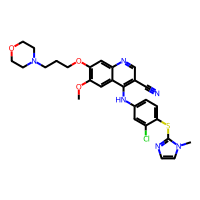
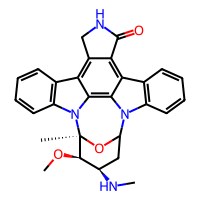
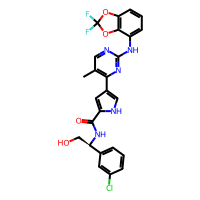
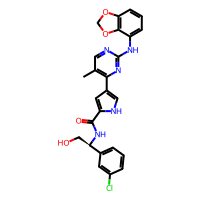
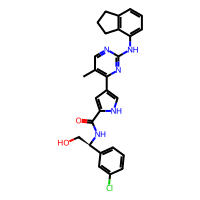
...
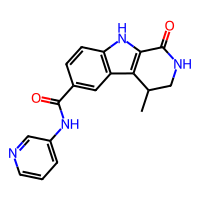
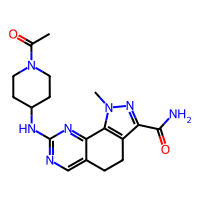
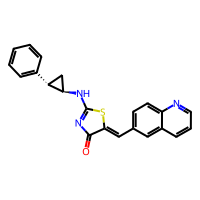
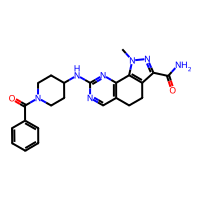
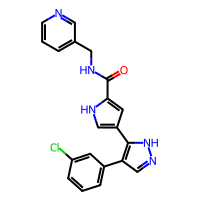

In [23]:
PandasTools.RenderImagesInAllDataFrames(images=True)
df

We can use a boxplot to examine the distribution of molecular weight within the dataframe. 

In [24]:
import seaborn as sns

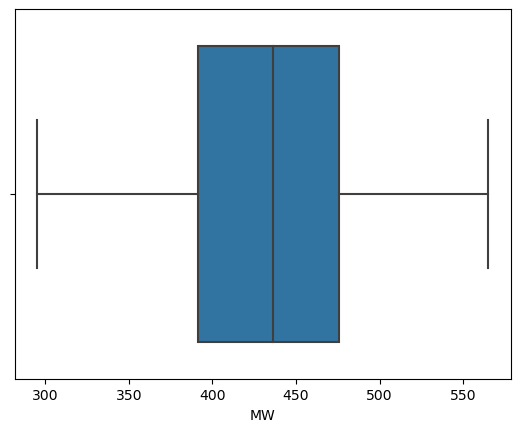

In [25]:
ax = sns.boxplot(x=df.MW)

# RDKit with CSV file

**Import data from a CSV file**

In [27]:
df = pd.read_csv("curated-solubility-dataset.csv")

Read the first few lines of the dataframe

In [29]:
# df.head()
pandas.io.formats.style.Styler(df.head())

,ID,Name,InChI,InChIKey,SMILES,Solubility,SD,Ocurrences,Group,MolWt,MolLogP,MolMR,HeavyAtomCount,NumHAcceptors,NumHDonors,NumHeteroatoms,NumRotatableBonds,NumValenceElectrons,NumAromaticRings,NumSaturatedRings,NumAliphaticRings,RingCount,TPSA,LabuteASA,BalabanJ,BertzCT
0,A-3,"N,N,N-trimethyloctadecan-1-aminium bromide","InChI=1S/C21H46N.BrH/c1-5-6-7-8-9-10-11-12-13-14-15-16-17-18-19-20-21-22(2,3)4;/h5-21H2,1-4H3;1H/q+1;/p-1",SZEMGTQCPRNXEG-UHFFFAOYSA-M,[Br-].CCCCCCCCCCCCCCCCCC[N+](C)(C)C,-3.616127,0.000000,1,G1,392.510000,3.958100,102.445400,23.000000,0.000000,0.000000,2.000000,17.000000,142.000000,0.000000,0.000000,0.000000,0.000000,0.000000,158.520601,0.000000,210.377334
1,A-4,Benzo[cd]indol-2(1H)-one,"InChI=1S/C11H7NO/c13-11-8-5-1-3-7-4-2-6-9(12-11)10(7)8/h1-6H,(H,12,13)",GPYLCFQEKPUWLD-UHFFFAOYSA-N,O=C1Nc2cccc3cccc1c23,-3.254767,0.000000,1,G1,169.183000,2.405500,51.901200,13.000000,1.000000,1.000000,2.000000,0.000000,62.000000,2.000000,0.000000,1.000000,3.000000,29.100000,75.183563,2.582996,511.229248
2,A-5,4-chlorobenzaldehyde,InChI=1S/C7H5ClO/c8-7-3-1-6(5-9)2-4-7/h1-5H,AVPYQKSLYISFPO-UHFFFAOYSA-N,Clc1ccc(C=O)cc1,-2.177078,0.000000,1,G1,140.569000,2.152500,36.839500,9.000000,1.000000,0.000000,2.000000,1.000000,46.000000,1.000000,0.000000,0.000000,1.000000,17.070000,58.261134,3.009782,202.661065
3,A-8,"zinc bis[2-hydroxy-3,5-bis(1-phenylethyl)benzoate]","InChI=1S/2C23H22O3.Zn/c2*1-15(17-9-5-3-6-10-17)19-13-20(22(24)21(14-19)23(25)26)16(2)18-11-7-4-8-12-18;/h2*3-16,24H,1-2H3,(H,25,26);/q;;+2/p-2",XTUPUYCJWKHGSW-UHFFFAOYSA-L,[Zn++].CC(c1ccccc1)c2cc(C(C)c3ccccc3)c(O)c(c2)C([O-])=O.CC(c4ccccc4)c5cc(C(C)c6ccccc6)c(O)c(c5)C([O-])=O,-3.924409,0.000000,1,G1,756.226000,8.116100,200.710600,53.000000,6.000000,2.000000,7.000000,10.000000,264.000000,6.000000,0.000000,0.000000,6.000000,120.720000,323.755434,0.000000,1964.648666
4,A-9,"4-({4-[bis(oxiran-2-ylmethyl)amino]phenyl}methyl)-N,N-bis(oxiran-2-ylmethyl)aniline","InChI=1S/C25H30N2O4/c1-5-20(26(10-22-14-28-22)11-23-15-29-23)6-2-18(1)9-19-3-7-21(8-4-19)27(12-24-16-30-24)13-25-17-31-25/h1-8,22-25H,9-17H2",FAUAZXVRLVIARB-UHFFFAOYSA-N,C1OC1CN(CC2CO2)c3ccc(Cc4ccc(cc4)N(CC5CO5)CC6CO6)cc3,-4.662065,0.000000,1,G1,422.525000,2.485400,119.076000,31.000000,6.000000,0.000000,6.000000,12.000000,164.000000,2.000000,4.000000,4.000000,6.000000,56.600000,183.183268,1.084427,769.899934


Examine the datatypes for the dataframe

In [30]:
df.dtypes

ID                      object
Name                    object
InChI                   object
InChIKey                object
SMILES                  object
Solubility             float64
SD                     float64
Ocurrences               int64
Group                   object
MolWt                  float64
MolLogP                float64
MolMR                  float64
HeavyAtomCount         float64
NumHAcceptors          float64
NumHDonors             float64
NumHeteroatoms         float64
NumRotatableBonds      float64
NumValenceElectrons    float64
NumAromaticRings       float64
NumSaturatedRings      float64
NumAliphaticRings      float64
RingCount              float64
TPSA                   float64
LabuteASA              float64
BalabanJ               float64
BertzCT                float64
dtype: object

The Pandas **describe** function provides summary statistics for numeric dataframe columns

In [31]:
pandas.io.formats.style.Styler(df.describe())

,Solubility,SD,Ocurrences,MolWt,MolLogP,MolMR,HeavyAtomCount,NumHAcceptors,NumHDonors,NumHeteroatoms,NumRotatableBonds,NumValenceElectrons,NumAromaticRings,NumSaturatedRings,NumAliphaticRings,RingCount,TPSA,LabuteASA,BalabanJ,BertzCT
count,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000,9982.000000
mean,-2.889909,0.067449,1.378081,266.665946,1.979167,66.794594,17.374674,3.486776,1.108595,5.196955,4.073031,94.243438,1.068323,0.292627,0.447606,1.515929,62.458601,108.912586,2.392199,467.336782
std,2.368154,0.234702,1.023476,184.179024,3.517738,46.523021,12.241536,3.498203,1.488973,4.736275,5.646925,64.748563,1.309427,0.879599,1.054667,1.644334,63.348307,76.462726,1.091123,546.631696
min,-13.171900,0.000000,1.000000,9.012000,-40.873200,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.504228,-0.000004,0.000000
25%,-4.326325,0.000000,1.000000,162.276000,0.619750,40.602475,11.000000,2.000000,0.000000,3.000000,1.000000,58.000000,0.000000,0.000000,0.000000,0.000000,26.300000,66.623721,2.004357,163.243343
50%,-2.618173,0.000000,1.000000,228.682000,1.949220,58.633400,15.000000,3.000000,1.000000,4.000000,3.000000,82.000000,1.000000,0.000000,0.000000,1.000000,50.720000,93.299873,2.539539,351.640433
75%,-1.209735,0.000000,1.000000,320.436000,3.419030,81.938000,21.000000,4.000000,2.000000,6.000000,5.000000,112.000000,2.000000,0.000000,1.000000,2.000000,80.390000,129.118374,3.032456,606.562848
max,2.137682,3.870145,38.000000,5299.456000,68.541140,1419.351700,388.000000,86.000000,26.000000,89.000000,141.000000,2012.000000,35.000000,30.000000,30.000000,36.000000,1214.340000,2230.685124,7.517310,20720.267708


The **columns** attribute of dataframe provides the column names

In [32]:
df.columns

Index(['ID', 'Name', 'InChI', 'InChIKey', 'SMILES', 'Solubility', 'SD',
       'Ocurrences', 'Group', 'MolWt', 'MolLogP', 'MolMR', 'HeavyAtomCount',
       'NumHAcceptors', 'NumHDonors', 'NumHeteroatoms', 'NumRotatableBonds',
       'NumValenceElectrons', 'NumAromaticRings', 'NumSaturatedRings',
       'NumAliphaticRings', 'RingCount', 'TPSA', 'LabuteASA', 'BalabanJ',
       'BertzCT'],
      dtype='object')

The **sort_values** function sorts a dataframe.  Note that this returns another dataframe.  To sort the dataframe in place set **inplace=True**

In [33]:
pandas.io.formats.style.Styler(df.sort_values("Group",ascending=False))

,ID,Name,InChI,InChIKey,SMILES,Solubility,SD,Ocurrences,Group,MolWt,MolLogP,MolMR,HeavyAtomCount,NumHAcceptors,NumHDonors,NumHeteroatoms,NumRotatableBonds,NumValenceElectrons,NumAromaticRings,NumSaturatedRings,NumAliphaticRings,RingCount,TPSA,LabuteASA,BalabanJ,BertzCT
9981,I-94,warfarin,"InChI=1S/C19H16O4/c1-12(20)11-15(13-7-3-2-4-8-13)17-18(21)14-9-5-6-10-16(14)23-19(17)22/h2-10,15,21H,11H2,1H3",PJVWKTKQMONHTI-UHFFFAOYSA-N,CC(=O)CC(c1ccccc1)c1c(O)c2ccccc2oc1=O,-4.780000,0.450506,3,G5,308.333000,3.609600,87.731800,23.000000,4.000000,1.000000,4.000000,4.000000,116.000000,3.000000,0.000000,0.000000,3.000000,67.510000,132.552025,2.258072,909.550973
8710,E-140,trichloroethylene,InChI=1S/C2HCl3/c3-1-2(4)5/h1H,XSTXAVWGXDQKEL-UHFFFAOYSA-N,ClC=C(Cl)Cl,-1.960000,0.063496,3,G5,131.389000,2.501700,25.642000,5.000000,0.000000,0.000000,3.000000,0.000000,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,45.324389,3.143197,42.854753
8765,E-530,ephedrine,"InChI=1S/C10H15NO/c1-8(11-2)10(12)9-6-4-3-5-7-9/h3-8,10-12H,1-2H3",KWGRBVOPPLSCSI-UHFFFAOYSA-N,OC(c(cccc1)c1)C(NC)C,-0.420000,0.049216,3,G5,165.236000,1.327900,49.923500,12.000000,2.000000,2.000000,2.000000,3.000000,66.000000,1.000000,0.000000,0.000000,1.000000,32.260000,73.235268,2.711041,222.540006
8764,E-521,phenallymal,"InChI=1S/C13H12N2O3/c1-2-8-13(9-6-4-3-5-7-9)10(16)14-12(18)15-11(13)17/h2-7H,1,8H2,(H2,14,15,16,17,18)",WOIGZSBYKGQJGL-UHFFFAOYSA-N,c1ccccc1C2(CC=C)C(=O)NC(=O)NC2=O,-2.180000,0.096968,4,G5,244.250000,0.866500,64.615400,18.000000,3.000000,2.000000,5.000000,3.000000,92.000000,1.000000,1.000000,1.000000,2.000000,75.270000,103.874854,2.560321,502.297711
8763,E-496,strychnine,"InChI=1S/C21H22N2O2/c24-18-10-16-19-13-9-17-21(6-7-22(17)11-12(13)5-8-25-16)14-3-1-2-4-15(14)23(18)20(19)21/h1-5,13,16-17,19-20H,6-11H2",QMGVPVSNSZLJIA-UHFFFAOYSA-N,O=C(N(c(c(C1(C(N(C2)CC(C3C4C5OC6)=C6)C3)C2)ccc7)c7)C14)C5,-3.320000,0.440782,3,G5,334.419000,2.092500,93.409000,25.000000,3.000000,0.000000,4.000000,0.000000,128.000000,1.000000,4.000000,6.000000,7.000000,32.780000,146.975680,1.552423,848.052734
8761,E-486,cocaine,"InChI=1S/C17H21NO4/c1-18-12-8-9-13(18)15(17(20)21-2)14(10-12)22-16(19)11-6-4-3-5-7-11/h3-7,12-15H,8-10H2,1-2H3",ZPUCINDJVBIVPJ-UHFFFAOYSA-N,COC(=O)C1C(CC2CCC1N2C)OC(=O)c3ccccc3,-2.230000,0.075865,3,G5,303.358000,1.867700,80.341500,22.000000,5.000000,0.000000,5.000000,3.000000,118.000000,1.000000,2.000000,2.000000,3.000000,55.840000,129.744072,1.789653,559.037182
8754,E-436,bis-(2-chloroethyl)_ether,InChI=1S/C4H8Cl2O/c5-1-3-7-4-2-6/h1-4H2,ZNSMNVMLTJELDZ-UHFFFAOYSA-N,ClCCOCCCl,-1.120000,0.092359,4,G5,143.013000,1.480600,32.259000,7.000000,1.000000,0.000000,3.000000,4.000000,44.000000,0.000000,0.000000,0.000000,0.000000,9.230000,53.554155,2.447473,28.870765
8753,E-434,o-chlorobenzoic_acid,"InChI=1S/C7H5ClO2/c8-6-4-2-1-3-5(6)7(9)10/h1-4H,(H,9,10)",IKCLCGXPQILATA-UHFFFAOYSA-N,O=C(O)c(c(ccc1)Cl)c1,-1.890000,0.084004,3,G5,156.568000,2.038200,38.411300,10.000000,1.000000,1.000000,3.000000,1.000000,52.000000,1.000000,0.000000,0.000000,1.000000,37.300000,63.055367,3.152941,257.537949
1799,A-2949,disodium sulfate,"InChI=1S/2Na.H2O4S/c;;1-5(2,3)4/h;;(H2,1,2,3,4)/q2*+1;/p-2",PMZURENOXWZQFD-UHFFFAOYSA-L,[Na+].[Na+].[O-][S]([O-])(=O)=O,0.126334,0.192866,3,G5,142.043000,-7.330000,10.474600,7.000000,4.000000,0.000000,7.000000,0.000000,32.000000,0.000000,0.000000,0.000000,0.000000,80.260000,85.832982,-0.000000,92.858202
8752,E-419,p-hydroxybenzoic_acid,"InChI=1S/C7H6O3/c8-6-3-1-5(2-4-6)7(9)10/h1-4,8H,(H,9,10)",FJKROLUGYXJWQN-UHFFFAOYSA-N,O=C(O)c(ccc(O)c1)c1,-1.410000,0.047950,4,G5,138.122000,1.090400,35.066100,10.000000,2.000000,2.000000,3.000000,1.000000,52.000000,1.000000,0.000000,0.000000,1.000000,57.530000,57.546335,3.003401,237.533061


The tqdm library provides a simple way of adding a progress bar to a python program.

In [34]:
tqdm.pandas()

Add the properties to the dataframe

In [35]:
df['Mol'] = df.SMILES.progress_apply(Chem.MolFromSmiles)

  0%|          | 0/9982 [00:00<?, ?it/s]

[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not removing hydrogen atom without neighbors
[10:31:24] WARNING: not r

In [36]:
query = Chem.MolFromSmarts("c1ccccn1")

In [37]:
query = Chem.MolFromSmarts("c1ccc[nH]1")

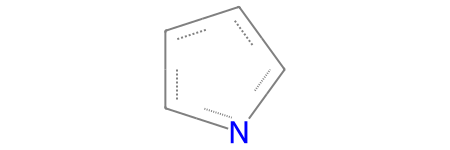

In [38]:
query

In [39]:
df['pyridine'] = [x.HasSubstructMatch(query) for x in tqdm(df.Mol)] #list of true or false

  0%|          | 0/9982 [00:00<?, ?it/s]

In [40]:
pandas.io.formats.style.Styler(df.head())

,ID,Name,InChI,InChIKey,SMILES,Solubility,SD,Ocurrences,Group,MolWt,MolLogP,MolMR,HeavyAtomCount,NumHAcceptors,NumHDonors,NumHeteroatoms,NumRotatableBonds,NumValenceElectrons,NumAromaticRings,NumSaturatedRings,NumAliphaticRings,RingCount,TPSA,LabuteASA,BalabanJ,BertzCT,Mol,pyridine
0,A-3,"N,N,N-trimethyloctadecan-1-aminium bromide","InChI=1S/C21H46N.BrH/c1-5-6-7-8-9-10-11-12-13-14-15-16-17-18-19-20-21-22(2,3)4;/h5-21H2,1-4H3;1H/q+1;/p-1",SZEMGTQCPRNXEG-UHFFFAOYSA-M,[Br-].CCCCCCCCCCCCCCCCCC[N+](C)(C)C,-3.616127,0.000000,1,G1,392.510000,3.958100,102.445400,23.000000,0.000000,0.000000,2.000000,17.000000,142.000000,0.000000,0.000000,0.000000,0.000000,0.000000,158.520601,0.000000,210.377334,,False
1,A-4,Benzo[cd]indol-2(1H)-one,"InChI=1S/C11H7NO/c13-11-8-5-1-3-7-4-2-6-9(12-11)10(7)8/h1-6H,(H,12,13)",GPYLCFQEKPUWLD-UHFFFAOYSA-N,O=C1Nc2cccc3cccc1c23,-3.254767,0.000000,1,G1,169.183000,2.405500,51.901200,13.000000,1.000000,1.000000,2.000000,0.000000,62.000000,2.000000,0.000000,1.000000,3.000000,29.100000,75.183563,2.582996,511.229248,,False
2,A-5,4-chlorobenzaldehyde,InChI=1S/C7H5ClO/c8-7-3-1-6(5-9)2-4-7/h1-5H,AVPYQKSLYISFPO-UHFFFAOYSA-N,Clc1ccc(C=O)cc1,-2.177078,0.000000,1,G1,140.569000,2.152500,36.839500,9.000000,1.000000,0.000000,2.000000,1.000000,46.000000,1.000000,0.000000,0.000000,1.000000,17.070000,58.261134,3.009782,202.661065,,False
3,A-8,"zinc bis[2-hydroxy-3,5-bis(1-phenylethyl)benzoate]","InChI=1S/2C23H22O3.Zn/c2*1-15(17-9-5-3-6-10-17)19-13-20(22(24)21(14-19)23(25)26)16(2)18-11-7-4-8-12-18;/h2*3-16,24H,1-2H3,(H,25,26);/q;;+2/p-2",XTUPUYCJWKHGSW-UHFFFAOYSA-L,[Zn++].CC(c1ccccc1)c2cc(C(C)c3ccccc3)c(O)c(c2)C([O-])=O.CC(c4ccccc4)c5cc(C(C)c6ccccc6)c(O)c(c5)C([O-])=O,-3.924409,0.000000,1,G1,756.226000,8.116100,200.710600,53.000000,6.000000,2.000000,7.000000,10.000000,264.000000,6.000000,0.000000,0.000000,6.000000,120.720000,323.755434,0.000000,1964.648666,,False
4,A-9,"4-({4-[bis(oxiran-2-ylmethyl)amino]phenyl}methyl)-N,N-bis(oxiran-2-ylmethyl)aniline","InChI=1S/C25H30N2O4/c1-5-20(26(10-22-14-28-22)11-23-15-29-23)6-2-18(1)9-19-3-7-21(8-4-19)27(12-24-16-30-24)13-25-17-31-25/h1-8,22-25H,9-17H2",FAUAZXVRLVIARB-UHFFFAOYSA-N,C1OC1CN(CC2CO2)c3ccc(Cc4ccc(cc4)N(CC5CO5)CC6CO6)cc3,-4.662065,0.000000,1,G1,422.525000,2.485400,119.076000,31.000000,6.000000,0.000000,6.000000,12.000000,164.000000,2.000000,4.000000,4.000000,6.000000,56.600000,183.183268,1.084427,769.899934,,False


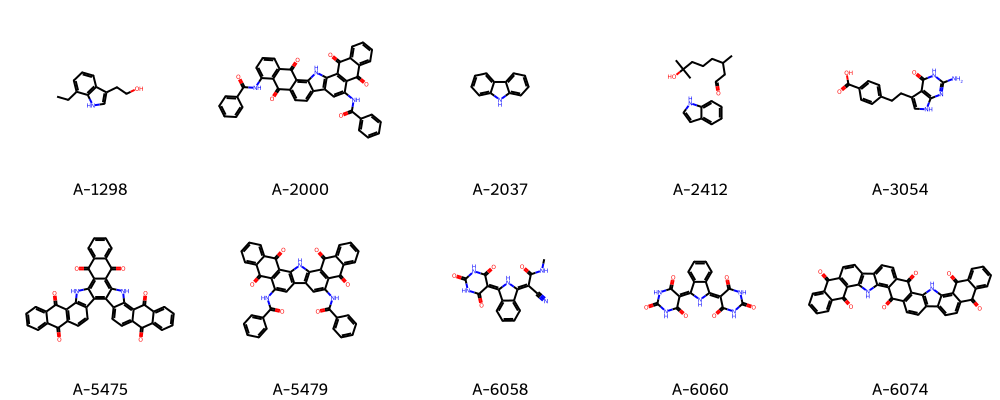

In [41]:
hits = df.query("pyridine").head(10)
MolsToGridImage(hits.Mol,legends=hits.ID.to_list(),molsPerRow=5)

In [42]:
match_list = [x.GetSubstructMatch(query) for x in hits.Mol] #Show atoms and bonds that have matched a substructure query

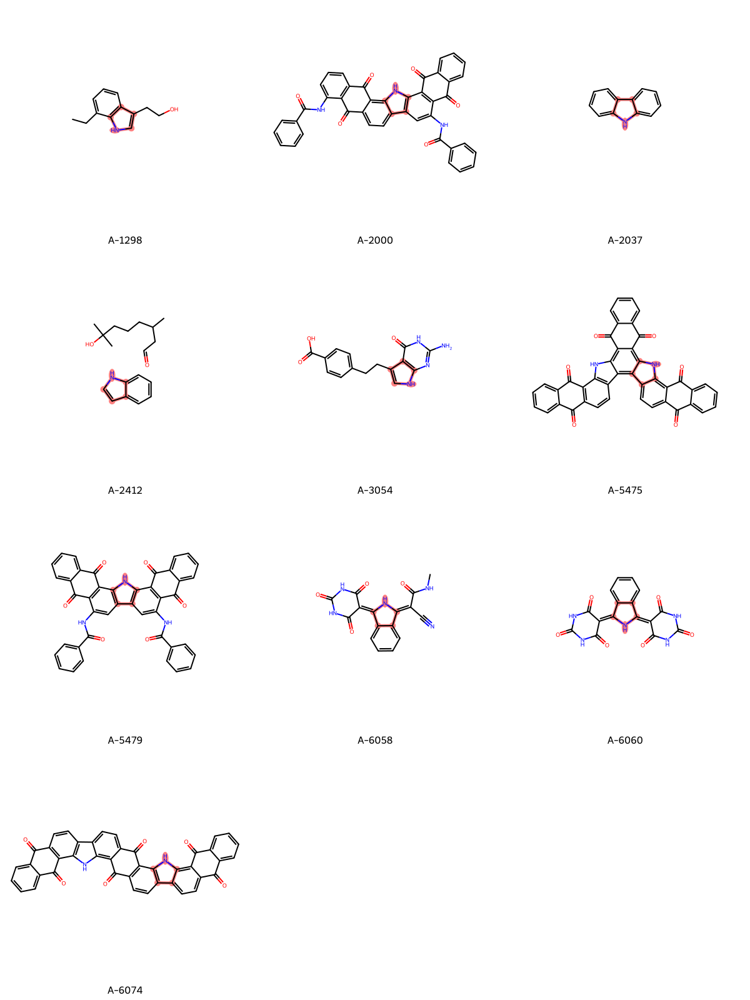

In [43]:
MolsToGridImage(hits.Mol,legends=hits.ID.to_list(),molsPerRow=3,highlightAtomLists=match_list,subImgSize=(400, 400))

Groupby by the solubility of the molecules :

In [44]:
res = []
for k,v in df.groupby("Group"):
    res.append([k,len(v),v.Solubility.mean()])
res_df = pd.DataFrame(res,columns=["Group","Size","Mean"]).round(decimals=2)

In [45]:
pandas.io.formats.style.Styler(res_df)

,Group,Size,Mean
0,G1,7746,-2.860000
1,G2,235,-4.050000
2,G3,1182,-2.790000
3,G4,183,-3.810000
4,G5,636,-2.680000


<AxesSubplot: title={'center': 'Solubility'}, xlabel='Group'>

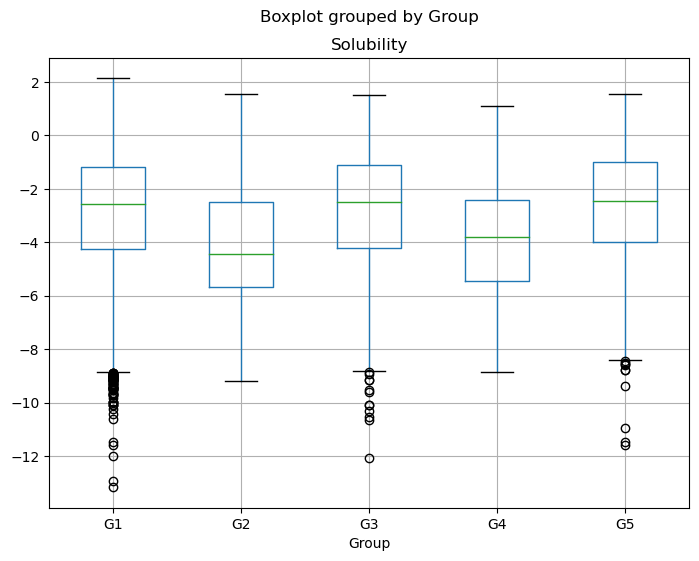

In [84]:
df.boxplot(column="Solubility",by="Group",figsize=(8,6))

<AxesSubplot: xlabel='Group', ylabel='Solubility'>

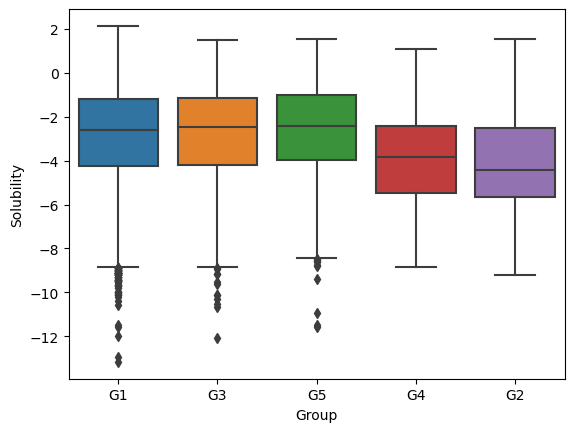

In [85]:
sns.boxplot(x="Group",y="Solubility",data=df)

In [83]:
for k,v in df.groupby("Group"):
    print(v)

        ID                                               Name  \
0      A-3         N,N,N-trimethyloctadecan-1-aminium bromide   
1      A-4                           Benzo[cd]indol-2(1H)-one   
2      A-5                               4-chlorobenzaldehyde   
3      A-8  zinc bis[2-hydroxy-3,5-bis(1-phenylethyl)benzo...   
4      A-9  4-({4-[bis(oxiran-2-ylmethyl)amino]phenyl}meth...   
...    ...                                                ...   
9973  I-77                                       sparfloxacin   
9975  I-80                                      sulfasalazine   
9977  I-84                                         tetracaine   
9978  I-85                                       tetracycline   
9980  I-93                                          verapamil   

                                                  InChI  \
0     InChI=1S/C21H46N.BrH/c1-5-6-7-8-9-10-11-12-13-...   
1     InChI=1S/C11H7NO/c13-11-8-5-1-3-7-4-2-6-9(12-1...   
2           InChI=1S/C7H5ClO/c8-7-3-1-6(5-